# VIAJAR A    ------>    TASMANIA 

Tasmania, conocida como la "isla de la inspiración", es un lugar de una belleza natural impresionante. Ubicada al sureste de Australia, se destaca por sus paisajes únicos, su rica vida silvestre y su patrimonio cultural.

![Alt text](<Data/Screenshot 2023-11-01 at 19.12.48.png>)

PHOTO BY SYLVIA YANG ON UNSPLASH

Photo by Christian Devereux on Unsplash

artwork found https://www.pinterest.com.au/pin/502573639641909270/

## Librerías y pre-procesamiento de datos

In [1]:
# Cargamos las librerías
import numpy as np
import pandas as pd
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt

import os
import json
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# mapas interactivos
import folium
from folium.plugins import FastMarkerCluster
import geopandas as gpd
from branca.colormap import LinearColormap

#to make the plotly graphs
import plotly.graph_objs as go
import chart_studio.plotly as py
from plotly.offline import iplot, init_notebook_mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)
import plotly.express as px

#text mining
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import re
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from wordcloud import WordCloud

In [2]:
# Leemos los csv y los almacenamos como dataframes en variables para trabajr con ellos
listings2 = pd.read_csv('/Users/erikadielingen/Tasmania_P/Data/listings.csv.gz')
listings = pd.read_csv('/Users/erikadielingen/Tasmania_P/Data/listings.csv')
reviews = pd.read_csv('/Users/erikadielingen/Tasmania_P/Data/reviews.csv.gz')
reviews2 = pd.read_csv('/Users/erikadielingen/Tasmania_P/Data/reviews.csv')
calendar = pd.read_csv('/Users/erikadielingen/Tasmania_P/Data/calendar.csv.gz')
neighbourhoods = pd.read_csv('/Users/erikadielingen/Tasmania_P/Data/neighbourhoods.csv')
# geo = geopandas.read_file('')

In [6]:
listings2.shape

(5838, 75)

In [7]:
listings.shape

(5838, 18)

In [8]:
#Vamos a ver qué columnas tienen cada una para poder ver con lo que estamos trabajando y añadir más información si lo necesitamos
print("Columns in listings DataFrame:", listings.columns)
print("Columns in listings2 DataFrame:", listings2.columns)

Columns in listings DataFrame: Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'number_of_reviews_ltm', 'license'],
      dtype='object')
Columns in listings2 DataFrame: Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'n

In [9]:
# Verificamos el index
print(listings.index.name)
print(listings2.index.name)

None
None


In [3]:
# Añadimos un index común y así poder hacer el siguiente paso del merge, que nos permite escoger columnas de un dataset y añadirlas al otro
listings.set_index('id', inplace=True)
listings2.set_index('id', inplace=True)

In [4]:
# Añadimos las columnas que parecen convenientes  verificamos la información de nuestro dataframe expandido
target_columns = ['maximum_nights', "property_type", "accommodates", "first_review", "review_scores_value", "review_scores_cleanliness", "review_scores_location", "review_scores_accuracy", "review_scores_communication", "review_scores_checkin", "review_scores_rating", "maximum_nights", "listing_url", "host_is_superhost", "host_about", "host_response_time", "host_response_rate", 'neighbourhood_group_cleansed']
listings = pd.merge(listings, listings2[target_columns], on='id', how='left')
listings.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5838 entries, 35644 to 972035238890070070
Data columns (total 35 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   name                            5838 non-null   object 
 1   host_id                         5838 non-null   int64  
 2   host_name                       5838 non-null   object 
 3   neighbourhood_group             0 non-null      float64
 4   neighbourhood                   5838 non-null   object 
 5   latitude                        5838 non-null   float64
 6   longitude                       5838 non-null   float64
 7   room_type                       5838 non-null   object 
 8   price                           5838 non-null   int64  
 9   minimum_nights                  5838 non-null   int64  
 10  number_of_reviews               5838 non-null   int64  
 11  last_review                     5470 non-null   object 
 12  reviews_per_month    

In [5]:
# Eliminamos las columnas con demasiados valores nulos, en estos casos están todas vacías
listings = listings.drop(columns=['neighbourhood_group', 'neighbourhood_group_cleansed', 'neighbourhood_group_cleansed'])

In [6]:
#Eliminamos el símbolo % de la columna 'host_response_rate' para una gráfica que haremos más adelante
listings['host_response_rate'] = pd.to_numeric(listings['host_response_rate'].str.strip('%'))

In [7]:
listings['host_response_rate']

id
35644                 100.0
84581                 100.0
88873                 100.0
137808                100.0
252996                100.0
                      ...  
968502695283059077    100.0
968511244145491520    100.0
968598945204335850    100.0
970139083708754850    100.0
972035238890070070    100.0
Name: host_response_rate, Length: 5838, dtype: float64

In [15]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5838 entries, 35644 to 972035238890070070
Data columns (total 33 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   name                            5838 non-null   object 
 1   host_id                         5838 non-null   int64  
 2   host_name                       5838 non-null   object 
 3   neighbourhood                   5838 non-null   object 
 4   latitude                        5838 non-null   float64
 5   longitude                       5838 non-null   float64
 6   room_type                       5838 non-null   object 
 7   price                           5838 non-null   int64  
 8   minimum_nights                  5838 non-null   int64  
 9   number_of_reviews               5838 non-null   int64  
 10  last_review                     5470 non-null   object 
 11  reviews_per_month               5470 non-null   float64
 12  calculated_host_listi

In [16]:
listings.head()

,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,...,review_scores_accuracy,review_scores_communication,review_scores_checkin,review_scores_rating,maximum_nights,listing_url,host_is_superhost,host_about,host_response_time,host_response_rate
id,,,,,,,,,,,,,,,,,,,,,
35644,Home in West Hobart · ★4.82 · 1 bedroom · 1 be...,153268,Yvette,Hobart,-42.87895,147.31526,Private room,50,1,257,...,4.87,4.96,4.96,4.82,7,https://www.airbnb.com/rooms/35644,t,I am an adjunct Senior Lecturer at the School ...,within an hour,100.0
84581,Home in West Kentish · ★4.98 · 3 bedrooms · 6 ...,461471,Melissa,Kentish,-41.38892,146.23196,Entire home/apt,295,2,117,...,4.95,4.97,4.97,4.98,90,https://www.airbnb.com/rooms/84581,t,"Life revolves around family, food and operatin...",within an hour,100.0
88873,Townhouse in Hobart · ★4.66 · 2 bedrooms · 3 b...,485048,Russell And Ingrid,Hobart,-42.88219,147.32253,Entire home/apt,125,2,560,...,4.76,4.86,4.93,4.66,365,https://www.airbnb.com/rooms/88873,f,We're Russell and Ingrid.\r\nIngrid is a schoo...,within an hour,100.0
137808,Home in Launceston · ★4.51 · 2 bedrooms · 7 b...,673625,Emma And Dale,Launceston,-41.42548,147.12855,Entire home/apt,239,1,369,...,4.72,4.66,4.81,4.51,180,https://www.airbnb.com/rooms/137808,f,This is a 2br house with polished floorboards ...,within an hour,100.0
252996,Guest suite in Gawler · ★4.90 · 1 bedroom · 1 ...,1090010,Kit,Central Coast,-41.23440,146.13398,Entire home/apt,125,2,74,...,4.93,4.95,4.90,4.90,14,https://www.airbnb.com/rooms/252996,t,"From London originally, now living here in Tas...",within an hour,100.0


In [17]:
listings.columns

Index(['name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365',
       'number_of_reviews_ltm', 'license', 'maximum_nights', 'property_type',
       'accommodates', 'first_review', 'review_scores_value',
       'review_scores_cleanliness', 'review_scores_location',
       'review_scores_accuracy', 'review_scores_communication',
       'review_scores_checkin', 'review_scores_rating', 'maximum_nights',
       'listing_url', 'host_is_superhost', 'host_about', 'host_response_time',
       'host_response_rate'],
      dtype='object')

In [8]:
listings.duplicated().value_counts()

False    5838
Name: count, dtype: int64

In [19]:
listings.isnull().sum().sort_values()

name                                 0
listing_url                          0
maximum_nights                       0
accommodates                         0
property_type                        0
number_of_reviews_ltm                0
availability_365                     0
calculated_host_listings_count       0
number_of_reviews                    0
maximum_nights                       0
price                                0
room_type                            0
longitude                            0
host_id                              0
latitude                             0
neighbourhood                        0
host_name                            0
minimum_nights                       0
license                             59
host_is_superhost                  153
last_review                        368
review_scores_rating               368
review_scores_checkin              368
review_scores_communication        368
review_scores_cleanliness          368
review_scores_location   

In [20]:
listings['price']

id
35644                  50
84581                 295
88873                 125
137808                239
252996                125
                     ... 
968502695283059077    250
968511244145491520    195
968598945204335850    145
970139083708754850    129
972035238890070070    120
Name: price, Length: 5838, dtype: int64

In [9]:
# Hacemos la conversión de la moneda dolar australiano -> euros
listings['price'] = listings['price'].apply(lambda x: (x*(3/5)))

In [10]:
# Vemos ahora los precios en euros
listings['price']

id
35644                  30.0
84581                 177.0
88873                  75.0
137808                143.4
252996                 75.0
                      ...  
968502695283059077    150.0
968511244145491520    117.0
968598945204335850     87.0
970139083708754850     77.4
972035238890070070     72.0
Name: price, Length: 5838, dtype: float64

# 2. Análisis exploratorio

## 2.1 Localidades

A continuación, podemos observar la cantidad de estadías disponibles por cada parte de Tasmanias. Este rincón australiano cuenta con una amplia variedad de opciones para alojarse y explorar. Desde la histórica ciudad de Hobart hasta la pintoresca costa este y las impresionantes montañas del oeste, cada vecindario tiene su encanto y atractivo especial.

También, podemos ver que la mayoría se encuentra en Hobart, lugar de mayor atracción y turismo por ser una ciudad tan importante, que ofrece lugares históricos, diversa gastronomía marítima, famosa por sus vinos y museos.

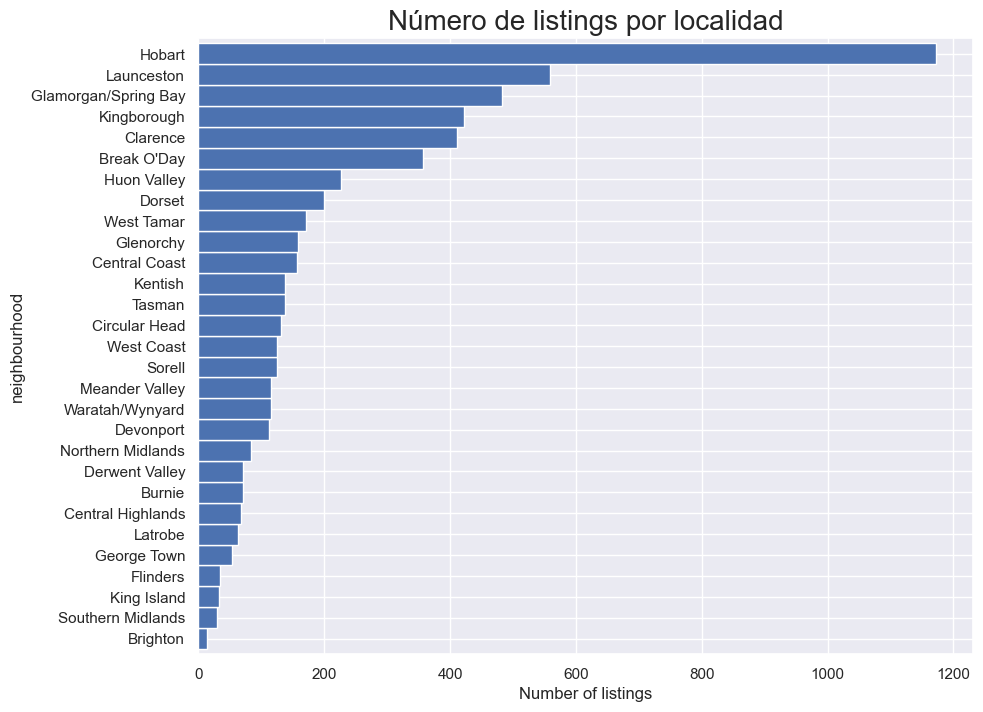

In [11]:
feq=listings['neighbourhood'].value_counts().sort_values(ascending=True)
feq.plot.barh(figsize=(10, 8), color='b', width=1)
plt.title("Número de listings por localidad", fontsize=20)
plt.xlabel('Number of listings', fontsize=12)
plt.show()

También lo podemos visualizar en el mapa:

![Alt text](<Data/Screenshot 2023-11-01 at 19.29.20.png>)

(Inside Airbnb: September 03 2023 | © Mapbox © OpenStreetMap)

## 2.2 Tipos de propiedades y habitaciones

### 2.2.1 Tipos de habitaciones

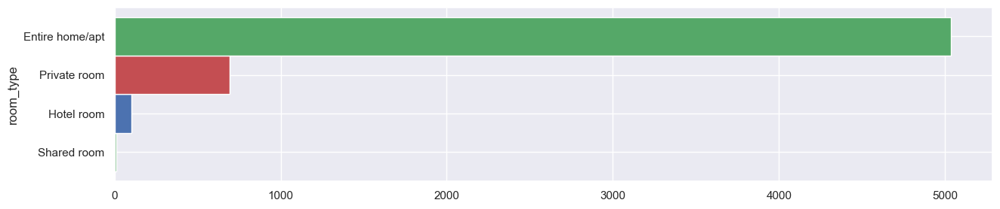

In [25]:
freq = listings['room_type']. value_counts().sort_values(ascending=True)
freq.plot.barh(figsize=(15, 3), width=1, color = ["g","b","r"])
plt.show()

### 2.2.2 Tipos de propiedades

In [17]:
listings.property_type.unique()

array(['Private room in home', 'Entire home', 'Entire townhouse',
       'Entire guest suite', 'Private room in bed and breakfast',
       'Entire loft', 'Private room in farm stay',
       'Private room in guesthouse', 'Entire cabin', 'Entire cottage',
       'Entire rental unit', 'Earthen home', 'Room in boutique hotel',
       'Entire guesthouse', 'Private room in guest suite', 'Farm stay',
       'Entire bungalow', 'Entire serviced apartment',
       'Private room in rental unit', 'Entire villa', 'Barn', 'Tiny home',
       'Room in bed and breakfast', 'Entire vacation home',
       'Shared room in hostel', 'Entire place', 'Castle', 'Entire chalet',
       'Entire condo', 'Hut', 'Room in serviced apartment',
       'Room in hotel', 'Private room in hostel', 'Camper/RV',
       'Private room in camper/rv', 'Tent', 'Private room in cabin',
       'Private room in bungalow', 'Private room in townhouse',
       'Private room in cottage', 'Bus', 'Private room in earthen home',
       'P

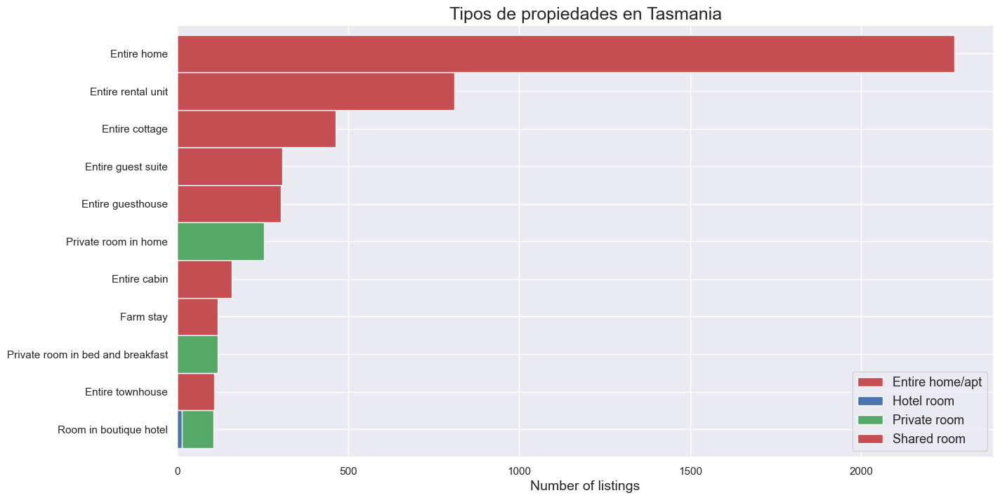

In [12]:
prop = listings.groupby(['property_type','room_type']).room_type.count()
prop = prop.unstack()
prop['total'] = prop.iloc[:,0:3].sum(axis = 1)
prop = prop.sort_values(by=['total'])
prop = prop[prop['total']>=100]
prop = prop.drop(columns=['total'])

prop.plot(kind='barh',stacked=True, color = ["r","b","g"],
              linewidth = 1, grid=True, figsize=(15,8), width=1)
plt.title('Tipos de propiedades en Tasmania', fontsize=18)
plt.xlabel('Number of listings', fontsize=14)
plt.ylabel("")
plt.legend(loc = 4,prop = {"size" : 13})
plt.rc('ytick', labelsize=13)
plt.show()

## 2.3 Número de alojados

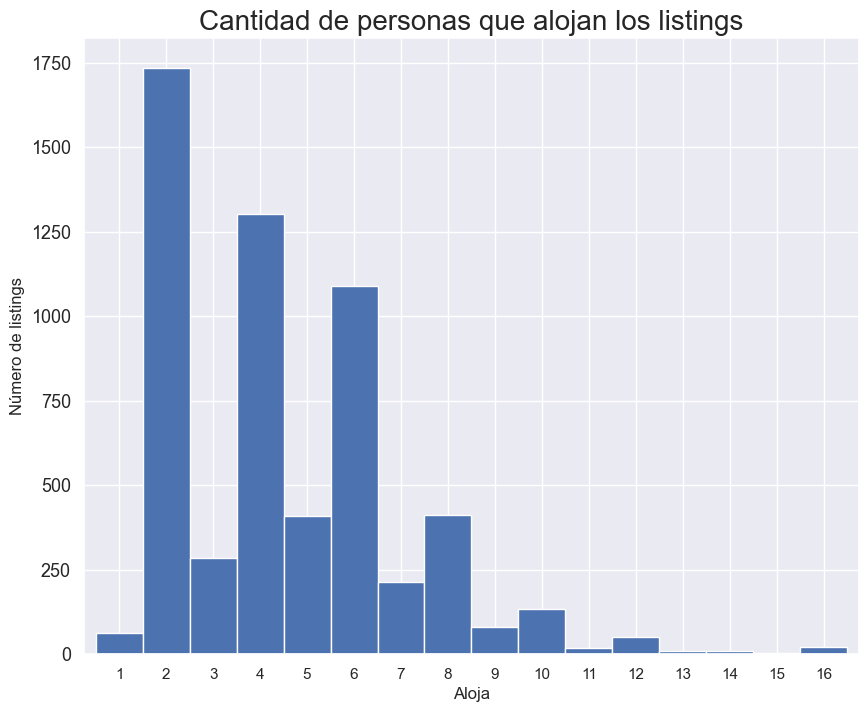

In [13]:
feq=listings['accommodates'].value_counts().sort_index()
feq.plot.bar(figsize=(10, 8), color='b', width=1, rot=0)
plt.title("Cantidad de personas que alojan los listings", fontsize=20)
plt.ylabel('Número de listings', fontsize=12)
plt.xlabel('Aloja', fontsize=12)
plt.show()

# 3. Consejos al turismo

## 3.1 Precio medio

A continuación también podemos observar el precio medio por día según la localización del alojamiento para dos personas:

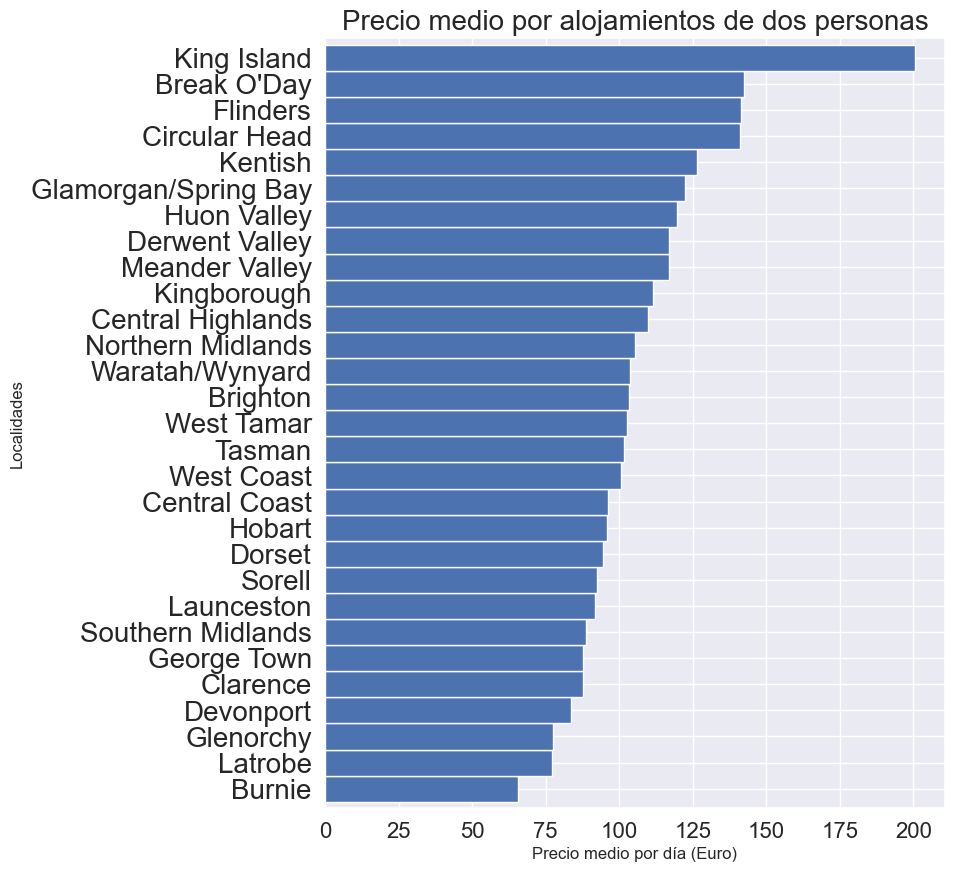

In [42]:
feq = listings[listings['accommodates']==2]
feq = feq.groupby('neighbourhood')['price'].mean().sort_values(ascending=True)
feq.plot.barh(figsize=(8, 10), color='b', width=1)
plt.title('Precio medio por alojamientos de dos personas', fontsize=20)
plt.xlabel('Precio medio por día (Euro)', fontsize=12)
plt.ylabel('Localidades')
plt.show()

In [8]:
f = pd.read_csv('/Users/erikadielingen/Tasmania_P/Data/neighbourhoods.csv')
f

,neighbourhood_group,neighbourhood
0,NaN,Break O'Day
1,NaN,Brighton
2,NaN,Burnie
3,NaN,Central Coast
4,NaN,Central Highlands
5,NaN,Circular Head
6,NaN,Clarence
7,NaN,Derwent Valley
8,NaN,Devonport
9,NaN,Dorset


In [20]:
listings['price']

id
35644                  30.0
84581                 177.0
88873                  75.0
137808                143.4
252996                 75.0
                      ...  
968502695283059077    150.0
968511244145491520    117.0
968598945204335850     87.0
970139083708754850     77.4
972035238890070070     72.0
Name: price, Length: 5838, dtype: float64

In [23]:
tas = gpd.read_file("/Users/erikadielingen/Tasmania_P/Data/neighbourhoods.geojson")
feq = listings[listings['accommodates']==2]
feq = feq.groupby('neighbourhood')['price'].mean().sort_values(ascending=True)
feq = pd.DataFrame([feq])
feq = feq.transpose()
tas = pd.merge(tas, feq, on='neighbourhood', how='left')
tas.rename(columns={'price': 'average_price'}, inplace=True)
tas = tas.dropna(subset=['average_price'])
tas.average_price = tas.average_price.round(decimals=0)

map_dict = tas.set_index('neighbourhood')['average_price'].to_dict()
color_scale = LinearColormap(['yellow','red'], vmin = min(map_dict.values()), vmax = max(map_dict.values()))

def get_color(feature):
    value = map_dict.get(feature['properties']['neighbourhood'])
    return color_scale(value)

map3 = folium.Map(location=[-41.640079, 146.315918], zoom_start=11)
folium.GeoJson(data=tas,
               name='Tasmania',
               tooltip=folium.features.GeoJsonTooltip(fields=['neighbourhood', 'average_price'],
                                                      labels=True,
                                                      sticky=False),
               style_function= lambda feature: {
                  'fillColor': get_color(feature), 
                   'color': 'black',
                   'weight': 1,
                   'dashArray': '5, 5',
                   'fillOpacity':0.5
                   },
               highlight_function=lambda feature: {'weight':3, 'fillColor': get_color(feature), 'fillOpacity': 0.8}).add_to(map3)
map3

## 3.3 Valoración por ubicación, y ubicación vs precio medio

En las dos siguientes gráficas hacemos dos comparaciones utilizando las valoraciones dejadas sobre los alojamientos y la media de precios por alojamientos de dos personas, que acabamos de ver posteriormente:

- A la izquierda tenemos la media general de valoración por localización.

- A la derecha tenemos la media de precios por un día de estadía, por la localización.

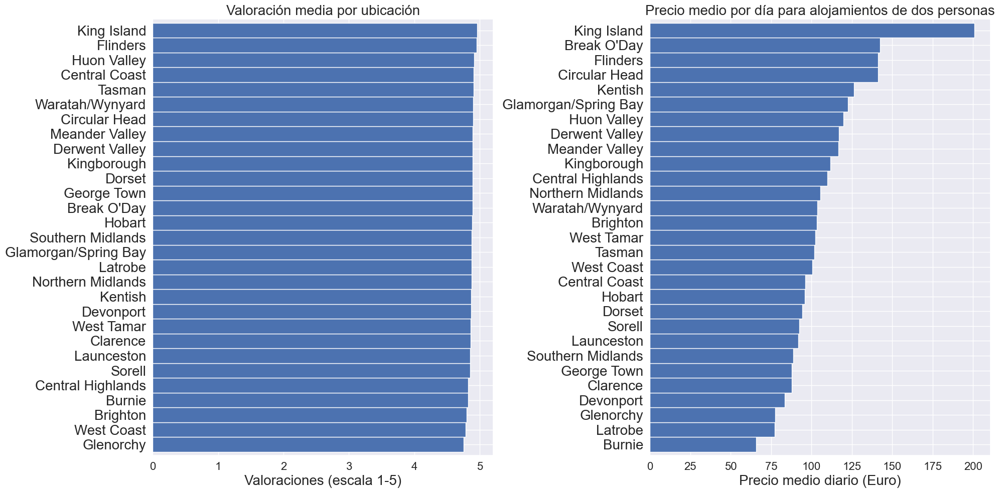

In [15]:
fig = plt.figure(figsize=(20,10))
plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=20)

ax1 = fig.add_subplot(121)
feq = listings[listings['number_of_reviews']>=10]
feq1 = feq.groupby('neighbourhood')['review_scores_location'].mean().sort_values(ascending=True)
ax1=feq1.plot.barh(color='b', width=1)
plt.title("Valoración media por ubicación", fontsize=20)
plt.xlabel('Valoraciones (escala 1-5)', fontsize=20)
plt.ylabel("")

ax2 = fig.add_subplot(122)
feq = listings[listings['accommodates']==2]
feq2 = feq.groupby('neighbourhood')['price'].mean().sort_values(ascending=True)
ax2=feq2.plot.barh(color='b', width=1)
plt.title("Precio medio por día para alojamientos de dos personas", fontsize=20)
plt.xlabel('Precio medio diario (Euro)', fontsize=20)
plt.ylabel("")

plt.tight_layout()
plt.show()

## 3.4 Puantaciones de las opiniones

También podemos observar que las valoraciones sobre otros aspectos más específicos también suele ser bastante buena.

* Limpieza. ¿El espacio estaba limpio y ordenado?
* Precisión. ¿Con qué precisión la página del listado representó su espacio?
* Valor. ¿Sintió que su listado proporcionó un buen valor por el precio?
* Comunicación. ¿Qué tan bien fue la comunicación con el anfitrión antes y durante su estadía?
* Llegada. ¿Qué tan bien fue su registro?
* Ubicación. ¿Cómo te sentiste en el barrio?

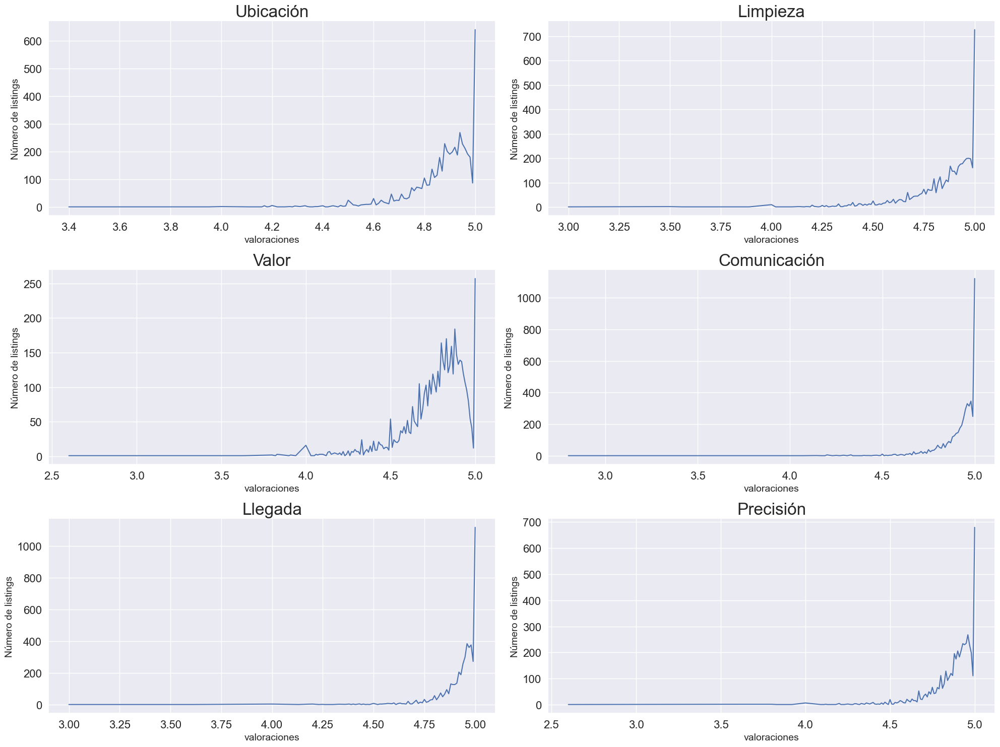

In [17]:
listings5 = listings[listings['number_of_reviews']>=5]

fig = plt.figure(figsize=(20,15))
plt.rc('xtick', labelsize=16) 
plt.rc('ytick', labelsize=16)

ax1 = fig.add_subplot(321)
feq=listings5['review_scores_location'].value_counts().sort_index()
ax1=feq.plot(color='b', rot=0)
#ax1.tick_params(axis = 'both', labelsize = 16)
plt.title("Ubicación", fontsize=24)
plt.ylabel('Número de listings', fontsize=14)
plt.xlabel('valoraciones', fontsize=14)

ax2 = fig.add_subplot(322)
feq=listings5['review_scores_cleanliness'].value_counts().sort_index()
ax2=feq.plot(color='b', rot=0)
plt.title("Limpieza", fontsize=24)
plt.ylabel('Número de listings', fontsize=14)
plt.xlabel('valoraciones', fontsize=14)

ax3 = fig.add_subplot(323)
feq=listings5['review_scores_value'].value_counts().sort_index()
ax3=feq.plot(color='b', rot=0)
plt.title("Valor", fontsize=24)
plt.ylabel('Número de listings', fontsize=14)
plt.xlabel('valoraciones', fontsize=14)

ax4 = fig.add_subplot(324)
feq=listings5['review_scores_communication'].value_counts().sort_index()
ax4=feq.plot(color='b', rot=0)
plt.title("Comunicación", fontsize=24)
plt.ylabel('Número de listings', fontsize=14)
plt.xlabel('valoraciones', fontsize=14)

ax5 = fig.add_subplot(325)
feq=listings5['review_scores_checkin'].value_counts().sort_index()
ax5=feq.plot(color='b', rot=0)
plt.title("Llegada", fontsize=24)
plt.ylabel('Número de listings', fontsize=14)
plt.xlabel('valoraciones', fontsize=14)

ax6 = fig.add_subplot(326)
feq=listings5['review_scores_accuracy'].value_counts().sort_index()
ax6=feq.plot(color='b', rot=0)
plt.title("Precisión", fontsize=24)
plt.ylabel('Número de listings', fontsize=14)
plt.xlabel('valoraciones', fontsize=14)

plt.tight_layout()
plt.show()

## 3.5 Encontrando un buen hospedador

¿Cuáles son las condiciones para ser un superanfitrión?

* Los Superanfitriones tienen una calificación general promedio de 4.8 o superior según las reseñas de al menos el 50 % de sus huéspedes de Airbnb durante el último año.
* Los Superhosts han alojado al menos 10 estadías en el último año o, si realizan reservas a más largo plazo, 100 noches en al menos 3 estadías.
* Los Superhosts no tienen cancelaciones en el último año, a menos que haya circunstancias atenuantes.
* Los Superhosts responden al 90 % de los mensajes nuevos en 24 horas.

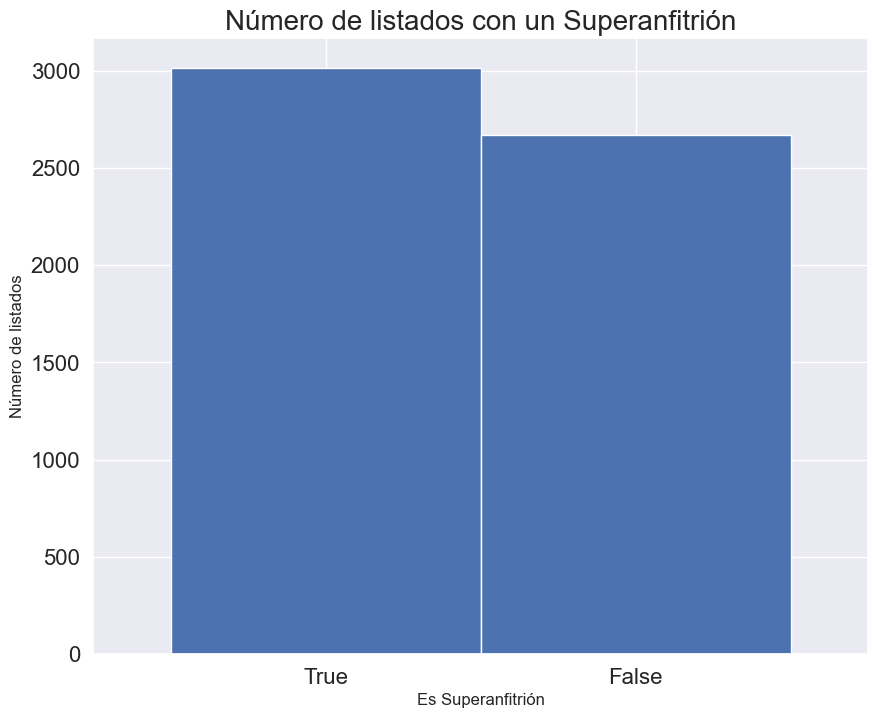

In [19]:
listings.host_is_superhost = listings.host_is_superhost.replace({"t": "True", "f": "False"})

feq=listings['host_is_superhost'].value_counts()
feq.plot.bar(figsize=(10, 8), width=1, rot=0)
plt.title("Número de listados con un Superanfitrión", fontsize=20)
plt.ylabel('Número de listados', fontsize=12)
plt.xlabel('Es Superanfitrión', fontsize=12)
plt.show()

Podemos ver que tenemos gran cantidad de superanfitriones. Y también podemos confirmar a continuación que la mayoría de anfitriones tanto reponde casi siempre y dentro de una hora. Podemos juzgar la atención de su parte como favorable.

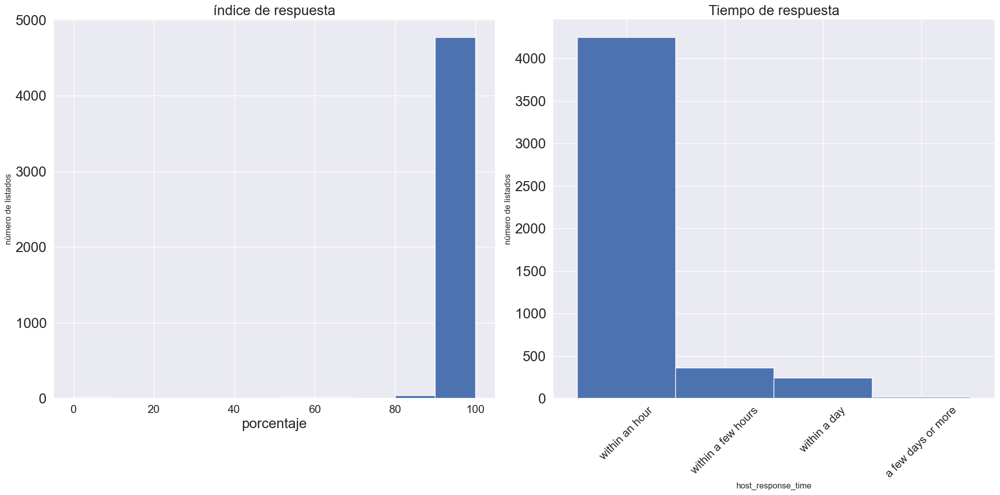

In [20]:
fig = plt.figure(figsize=(20,10))
plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=20)

ax1 = fig.add_subplot(121)
feq1 = listings['host_response_rate'].dropna()
ax1= plt.hist(feq1)
plt.title("índice de respuesta", fontsize=20)
plt.ylabel("número de listados")
plt.xlabel("porcentaje", fontsize=20)

ax2 = fig.add_subplot(122)
feq2 = listings['host_response_time'].value_counts()
ax2=feq2.plot.bar(color='b', width=1, rot=45)
plt.title("Tiempo de respuesta", fontsize=20)
plt.ylabel("número de listados")

plt.tight_layout()
plt.show()

## 3.6 Disponibilidad en el tiempo

### _.

In [21]:
calendar

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,35644,2023-09-04,f,$50.00,$50.00,1,7
1,35644,2023-09-05,f,$50.00,$50.00,1,7
2,35644,2023-09-06,f,$50.00,$50.00,1,7
3,35644,2023-09-07,f,$50.00,$50.00,1,7
4,35644,2023-09-08,f,$50.00,$50.00,1,7
...,...,...,...,...,...,...,...
2130867,972035238890070070,2024-08-28,f,$120.00,$120.00,1,1125
2130868,972035238890070070,2024-08-29,f,$120.00,$120.00,1,1125
2130869,972035238890070070,2024-08-30,f,$120.00,$120.00,1,1125
2130870,972035238890070070,2024-08-31,f,$120.00,$120.00,1,1125


In [22]:
calendar.price = calendar.price.str.replace(",","")
calendar['price'] = pd.to_numeric(calendar['price'].str.strip('$'))
calendar['price'] = calendar['price'].apply(lambda x: (x*(3/5)))
calendar = calendar[calendar.date < '2024-12-05']

In [23]:
print(calendar.shape)

(2130872, 7)


In [24]:
calendar.set_index('listing_id', inplace=True)

In [25]:
calendar['date'] = pd.to_datetime(calendar['date'])

In [26]:
listings.index.name = "listing_id"
calendar = pd.merge(calendar, listings[['accommodates']], on = "listing_id", how = "left")
calendar.sample(15)

,date,available,price,adjusted_price,minimum_nights,maximum_nights,accommodates
listing_id,,,,,,,
4144733,2023-09-24,t,88.8,$148.00,2,1125,6
40284348,2024-02-23,t,165.0,$275.00,2,1125,5
28055504,2024-04-13,t,219.0,$365.00,1,365,2
672657802974264455,2024-02-21,f,75.0,$125.00,1,1125,6
35975525,2024-01-15,f,156.0,$260.00,2,1125,6
31225483,2024-05-26,f,114.0,$190.00,2,7,2
54073526,2023-09-16,t,57.0,$95.00,2,28,2
30206300,2024-02-04,f,135.0,$225.00,2,31,4
9312599,2024-06-15,t,150.0,$250.00,2,1125,6


### Gráfico: número de listados disponibles por fecha y variaciones a lo largo del año.

In [27]:
sum_available = calendar[calendar.available == "t"].groupby(['date']).size().to_frame(name= 'available').reset_index()
sum_available['weekday'] = sum_available['date'].dt.day_name()
sum_available = sum_available.set_index('date')

sum_available.iplot(y='available', mode = 'lines', xTitle = 'Fecha', yTitle = 'Número de listados disponibles',\
                   text='weekday', title = 'Número de listados disponibles por fecha')

## 3.7 Precio medio por día

In [28]:
average_price = calendar[(calendar['available'] == "t") & (calendar['accommodates'] == 2)].groupby(['date'])['price'].mean().astype(np.int64).reset_index()
average_price['weekday'] = average_price['date'].dt.day_name()
average_price = average_price.set_index('date')

average_price.iplot(y='price', mode='lines', xTitle='Fecha', yTitle='Precio',
    text='weekday', title='Precio medio por alojamientos disponibles para dos presonas')

### _

- ¿Por qué parece que los precios tienen un peak de aumento hacia finales de 2024?

In [42]:
filtered_calendar = calendar[(calendar['available'] == "t") & (calendar['accommodates'] == 2) & (calendar['date'] > '2024-08-25')]

In [43]:
grouped_calendar = filtered_calendar.groupby('date')['price'].mean()

In [44]:
grouped_calendar

date
2024-08-26    127.858419
2024-08-27    127.800000
2024-08-28    127.789738
2024-08-29    127.867577
2024-08-30    130.013272
2024-08-31    136.171134
2024-09-01    138.831031
2024-09-02    163.077736
Name: price, dtype: float64

# Sugerencias

Tasmania es conocido por ofrecer los mejores aspectos de la ciudad, ocio y cultura, con una exótica y diversa vida salvaje, espacios verdes y maravillas.

Así, podemos encontrar múltiples playas, ríos, parques nacionales, más de 400 zonas de conservación, múltiples senderos para caminar, cuevas, montes, y muchas más maravillas naturales:

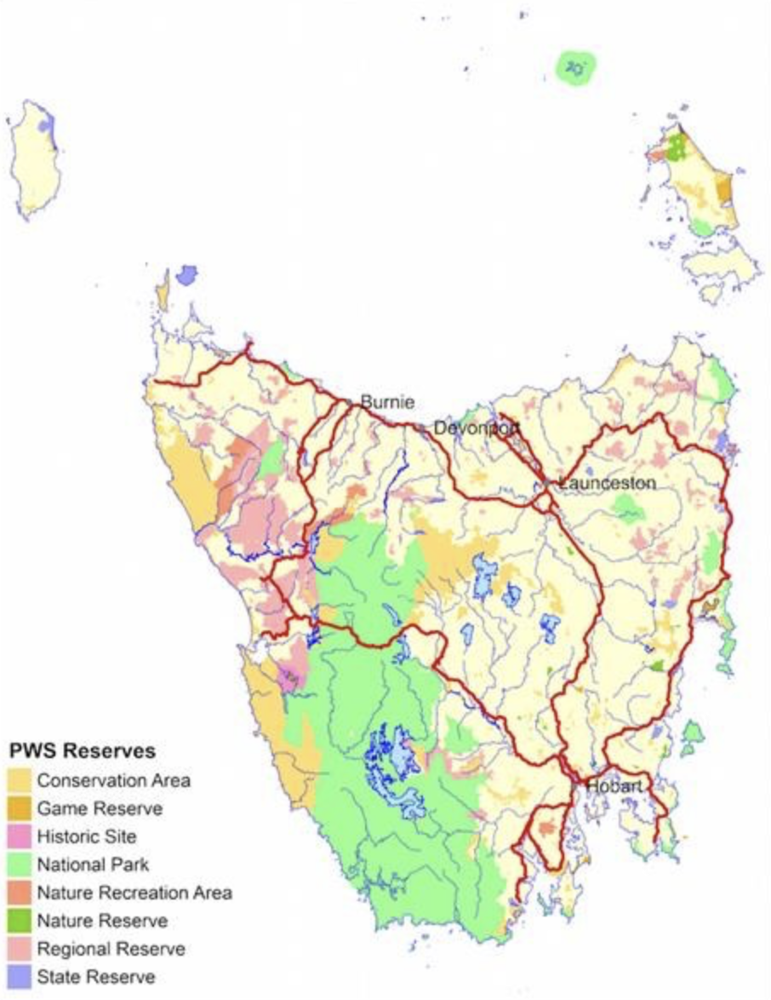

In [60]:
from IPython.display import display, Image
# Display la imagen
display(Image('/Users/erikadielingen/Tasmania_P/Data/Screenshot 2023-11-02 at 11.40.02.png',  width=700, height=20))

Tasmanian Parks and Wildlife Service (PWS)

![Alt text](<Data/Screenshot 2023-11-02 at 11.45.43.png>)

Aurora Australis. Image Credit: @oliver.whone

![Alt text](<Data/Screenshot 2023-11-02 at 12.10.45.png>)

Mount Wellington, Hobart, Tasmania © Tourism Australia

![Alt text](<Data/Screenshot 2023-11-02 at 12.14.40.png>)

https://tracystravelsintime.com/2019/03/19/tasmania-animal-guide/

Más sobre la vida animal en: http://www.ourtasmania.com.au/tas-wildlife.html

También encontramos lugares culturales bastante icónicos e importantes en Tasmania:

Cascade Brewery, 1824

![Alt text](<Data/Screenshot 2023-11-02 at 12.00.29.png>)

https://www.beerandcroissants.com/best-brewery-tour-in-tasmania/

El museo de arte 'Museum of Old and New Art'

![Alt text](<Data/Screenshot 2023-11-02 at 12.10.02.png>)

Museum of Old and New Art (Mona), Hobart, Tasmania © Rob Burnett, Tourism Tasmania

# 5. A partir de las valoraciones: palabras más usadas

### _

In [20]:
reviews.shape

(482656, 6)

In [21]:
reviews2.shape

(482656, 2)

In [24]:
reviews2.columns

Index(['listing_id', 'date'], dtype='object')

In [60]:
reviews

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,35644,3024649,2012-12-04,5394983,Anne,yvette picked us bus stop arrival hobart. imme...
1,35644,3040421,2012-12-08,3712269,Catherine,"lovely house beautiful views, close city centr..."
2,35644,3126050,2012-12-20,2908896,Paul,yvette generous host georgeous person. made fe...
3,35644,3142082,2012-12-23,3941752,Carmel,first experience air b & b; excellent experien...
4,35644,3194549,2012-12-31,2735578,Katharina,yvette friendly host happy give lots advice go...
...,...,...,...,...,...,...
482651,937392657131881793,959779548822668655,2023-08-17,475266840,Alex,loved staying here. cute little studio everyth...
482652,938137047644160743,954670326414767346,2023-08-10,527522467,Thomas,"angela amazing, everything ready plenty time. ..."
482653,938137047644160743,959783245336934722,2023-08-17,430747803,Emily,perfect little home away home! great place sta...
482654,938137047644160743,961912369148516081,2023-08-20,24138702,Sarah,great stay suburban area launceston. great alt...


In [50]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/erikadielingen/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [52]:
#remove numbers
reviews['comments'] = reviews['comments'].str.replace('\d+', '') 
#all to lowercase
reviews['comments'] = reviews['comments'].str.lower()
#remove windows new line
reviews['comments'] = reviews['comments'].str.replace('\r\n', "")
#remove stopwords (from nltk library)
stop_english = stopwords.words("english")
reviews['comments'] = reviews['comments'].apply(lambda x: " ".join([i for i in x.split() 
                                                      if i not in (stop_english)]))
# remove punctuation
reviews['comments'] = reviews['comments'].str.replace('[^\w\s]'," ")
# replace x spaces by one space
reviews['comments'] = reviews['comments'].str.replace('\s+', ' ')

reviews.comments.values[4] #print same comments again

'yvette friendly host happy give lots advice go do. enjoyed interesting chats really good coffee :)'

In [53]:
texts = reviews.comments.tolist()

vec = CountVectorizer().fit(texts)
bag_of_words = vec.transform(texts)
sum_words = bag_of_words.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]

cvec_df = pd.DataFrame.from_records(words_freq, columns= ['words', 'counts']).sort_values(by="counts", ascending=False)
cvec_df.head(10)

,words,counts
19,stay,239247
22,great,232890
79,place,204736
47,br,159109
224,location,135994
17,house,104846
236,clean,104404
15,lovely,104024
61,beautiful,102846
16,comfortable,93151


### Visual

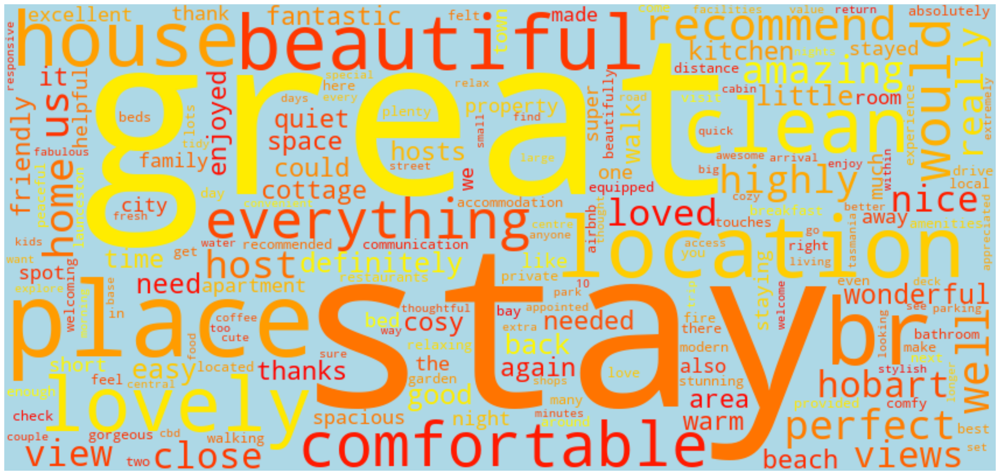

In [109]:
cvec_dict = dict(zip(cvec_df.words, cvec_df.counts))

wordcloud = WordCloud(width=850, height=400, colormap= 'autumn_r', background_color= 'lightblue')
wordcloud.generate_from_frequencies(frequencies=cvec_dict)
plt.figure( figsize=(30,25) )
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()